<a href="https://colab.research.google.com/github/Radha54/HEALTH-INSURANCE-CROSS-SELL-PREDICTION/blob/main/HEALTH_INSURANCE_CROSS_SELL_PREDICTION.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Problem Statement**

Our client is an Insurance company that has provided Health Insurance to its customers now they need your help in building a model to predict whether the policyholders (customers) from past year will also be interested in Vehicle Insurance provided by the company.

An insurance policy is an arrangement by which a company undertakes to provide a guarantee of compensation for specified loss, damage, illness, or death in return for the payment of a specified premium. A premium is a sum of money that the customer needs to pay regularly to an insurance company for this guarantee.

For example, you may pay a premium of Rs. 5000 each year for a health insurance cover of Rs. 200,000/- so that if, God forbid, you fall ill and need to be hospitalised in that year, the insurance provider company will bear the cost of hospitalisation etc. for upto Rs. 200,000. Now if you are wondering how can company bear such high hospitalisation cost when it charges a premium of only Rs. 5000/-, that is where the concept of probabilities comes in picture. For example, like you, there may be 100 customers who would be paying a premium of Rs. 5000 every year, but only a few of them (say 2-3) would get hospitalised that year and not everyone. This way everyone shares the risk of everyone else.

Just like medical insurance, there is vehicle insurance where every year customer needs to pay a premium of certain amount to insurance provider company so that in case of unfortunate accident by the vehicle, the insurance provider company will provide a compensation (called ‘sum assured’) to the customer.

Building a model to predict whether a customer would be interested in Vehicle Insurance is extremely helpful for the company because it can then accordingly plan its communication strategy to reach out to those customers and optimise its business model and revenue.

Now, in order to predict, whether the customer would be interested in Vehicle insurance, you have information about demographics (gender, age, region code type), Vehicles (Vehicle Age, Damage), Policy (Premium, sourcing channel) etc.

# **Attribute Information**

1. id :	Unique ID for the customer

2. Gender	: Gender of the customer

3. Age :	Age of the customer

4. Driving_License	0 : Customer does not have DL, 1 : Customer already has DL

5. Region_Code :	Unique code for the region of the customer

6. Previously_Insured	: 1 : Customer already has Vehicle Insurance, 0 : Customer doesn't have Vehicle Insurance

7. Vehicle_Age :	Age of the Vehicle

8. Vehicle_Damage	 :1 : Customer got his/her vehicle damaged in the past. 0 : Customer didn't get his/her vehicle damaged in the past.

9. Annual_Premium	: The amount customer needs to pay as premium in the year

10. PolicySalesChannel :	Anonymized Code for the channel of outreaching to the customer ie. Different Agents, Over Mail, Over Phone, In Person, etc.

11. Vintage :	Number of Days, Customer has been associated with the company

12. Response :	1 : Customer is interested, 0 : Customer is not interested

IMPORTING LIBRARY

In [ ]:
# Building the network 
import numpy as np

# Visualization
import matplotlib as mpl   
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

# Train and Test split on data
from sklearn.preprocessing import LabelEncoder 
from sklearn.model_selection import train_test_split

# importing library for model
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import precision_score,recall_score,accuracy_score,f1_score,confusion_matrix,roc_auc_score,classification_report
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
sns.set_theme(style="darkgrid")

# Loading in the data
import sklearn
from sklearn.datasets import load_breast_cancer 

# Progress Bar
import tqdm as tqdm

#supresses warnings
import warnings
warnings.filterwarnings("ignore")

MOUNTING OF GOOGLE DRIVE

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


READING THE DATA DROM GOOGLE DRIVE

In [ ]:
health_df = pd.read_csv("/content/drive/My Drive/HEALTH INSURANCE CROSS SELL PREDICTION - Radha/HEALTH INSURANCE CROSS SELL PREDICTION.csv")

DATASET INSPECTION

In [ ]:
health_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 381109 entries, 0 to 381108
Data columns (total 12 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   id                    381109 non-null  int64  
 1   Gender                381109 non-null  object 
 2   Age                   381109 non-null  int64  
 3   Driving_License       381109 non-null  int64  
 4   Region_Code           381109 non-null  float64
 5   Previously_Insured    381109 non-null  int64  
 6   Vehicle_Age           381109 non-null  object 
 7   Vehicle_Damage        381109 non-null  object 
 8   Annual_Premium        381109 non-null  float64
 9   Policy_Sales_Channel  381109 non-null  float64
 10  Vintage               381109 non-null  int64  
 11  Response              381109 non-null  int64  
dtypes: float64(3), int64(6), object(3)
memory usage: 34.9+ MB


# <B> OBSERVATION : </B> 
<h6> 12 Columns, 381109 entries

dtypes: float64(3), int64(6), object(3)

Memory used : 34.9+ MB

In [ ]:
health_df.describe()

,id,Age,Driving_License,Region_Code,Previously_Insured,Annual_Premium,Policy_Sales_Channel,Vintage,Response
count,381109.000000,381109.000000,381109.000000,381109.000000,381109.000000,381109.000000,381109.000000,381109.000000,381109.000000
mean,190555.000000,38.822584,0.997869,26.388807,0.458210,30564.389581,112.034295,154.347397,0.122563
std,110016.836208,15.511611,0.046110,13.229888,0.498251,17213.155057,54.203995,83.671304,0.327936
min,1.000000,20.000000,0.000000,0.000000,0.000000,2630.000000,1.000000,10.000000,0.000000
25%,95278.000000,25.000000,1.000000,15.000000,0.000000,24405.000000,29.000000,82.000000,0.000000
50%,190555.000000,36.000000,1.000000,28.000000,0.000000,31669.000000,133.000000,154.000000,0.000000
75%,285832.000000,49.000000,1.000000,35.000000,1.000000,39400.000000,152.000000,227.000000,0.000000
max,381109.000000,85.000000,1.000000,52.000000,1.000000,540165.000000,163.000000,299.000000,1.000000


# <B> OBSERVATION : </B>
<h6>
Statistical Data of Numerical value at different point like mean, different value at minimum, 25%, 50%, 75% and at maximum.

In [ ]:
health_df.shape

(381109, 12)

In [ ]:
# First 5 rows of the data
health_df.head()

,id,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage,Response
0,1,Male,44,1,28.0,0,> 2 Years,Yes,40454.0,26.0,217,1
1,2,Male,76,1,3.0,0,1-2 Year,No,33536.0,26.0,183,0
2,3,Male,47,1,28.0,0,> 2 Years,Yes,38294.0,26.0,27,1
3,4,Male,21,1,11.0,1,< 1 Year,No,28619.0,152.0,203,0
4,5,Female,29,1,41.0,1,< 1 Year,No,27496.0,152.0,39,0


In [ ]:
# Last 5 rows of the data
health_df.tail()

,id,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage,Response
381104,381105,Male,74,1,26.0,1,1-2 Year,No,30170.0,26.0,88,0
381105,381106,Male,30,1,37.0,1,< 1 Year,No,40016.0,152.0,131,0
381106,381107,Male,21,1,30.0,1,< 1 Year,No,35118.0,160.0,161,0
381107,381108,Female,68,1,14.0,0,> 2 Years,Yes,44617.0,124.0,74,0
381108,381109,Male,46,1,29.0,0,1-2 Year,No,41777.0,26.0,237,0


In [ ]:
health_df.isnull().sum()

id                      0
Gender                  0
Age                     0
Driving_License         0
Region_Code             0
Previously_Insured      0
Vehicle_Age             0
Vehicle_Damage          0
Annual_Premium          0
Policy_Sales_Channel    0
Vintage                 0
Response                0
dtype: int64

In [ ]:
health_df.nunique()

id                      381109
Gender                       2
Age                         66
Driving_License              2
Region_Code                 53
Previously_Insured           2
Vehicle_Age                  3
Vehicle_Damage               2
Annual_Premium           48838
Policy_Sales_Channel       155
Vintage                    290
Response                     2
dtype: int64

In [ ]:
health_df.columns

Index(['id', 'Gender', 'Age', 'Driving_License', 'Region_Code',
       'Previously_Insured', 'Vehicle_Age', 'Vehicle_Damage', 'Annual_Premium',
       'Policy_Sales_Channel', 'Vintage', 'Response'],
      dtype='object')

# <B> OBSERVATION : </B> <h6>
Row - 381109, Columns - 12

NO Null value

Unique ID : 381109 and different columns having different no. of unique values

In [ ]:
health_df['Vehicle_Damage'].value_counts()

Yes    192413
No     188696
Name: Vehicle_Damage, dtype: int64

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


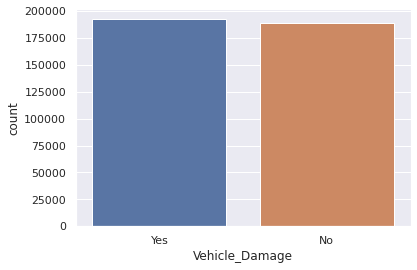

In [ ]:
sns.set_theme(style="darkgrid")
sns.countplot(health_df['Vehicle_Damage'],data=health_df)

Text(0.5, 1.0, 'Vehicle Damage & Previously Insuranced by people')

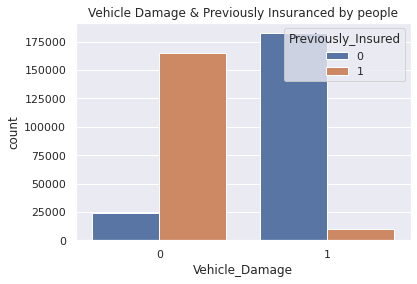

In [ ]:
# Relationship between Vehicle damage and previously insuranced people
sns.countplot(health_df['Vehicle_Damage'],hue=health_df['Previously_Insured'])
plt.title("Vehicle Damage & Previously Insuranced by people")

VISUALIZATION OF DATA OR GRAPHICAL REPRESENTATION OF DATA

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


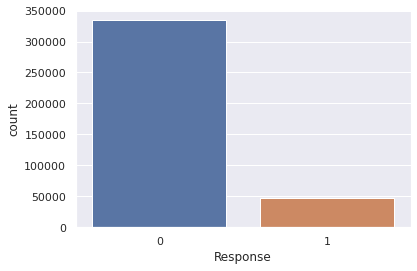

In [ ]:
# We know that Response having only two value. The graph is not good because response is very low.
sns.set_theme(style="darkgrid")
sns.countplot(health_df['Response'],data=health_df)

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


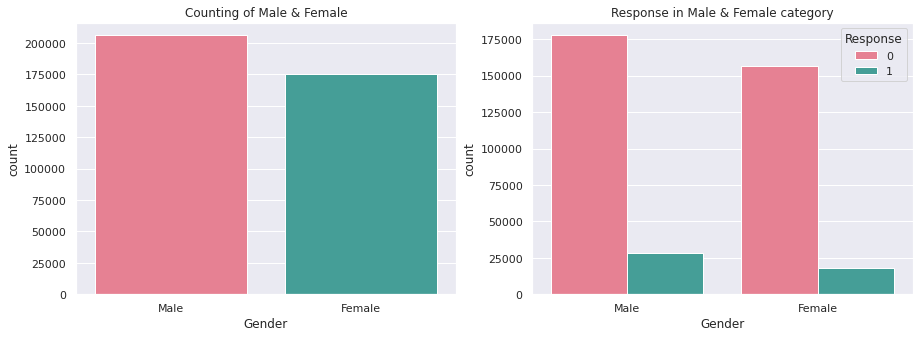

In [ ]:
# In this graph trying to count no of Male and female as well as their response also. In this trying to check that who will took more Insurance.
plt.figure(figsize = (15,5))
plt.subplot(1,2,1)
sns.countplot(health_df['Gender'],palette='husl')
plt.title("Counting of Male & Female")

plt.subplot(1,2,2)
sns.countplot(health_df['Gender'], hue = health_df['Response'],palette="husl")
plt.title("Response in Male & Female category")
plt.show()

# <B> OBSERVATION :</B> <h6>
In First graph, No. of Male is more than Female.

In 2nd graph, Male category is little bit more than female.

Chances of buying the insurance is also little high in Male as compared to Female.


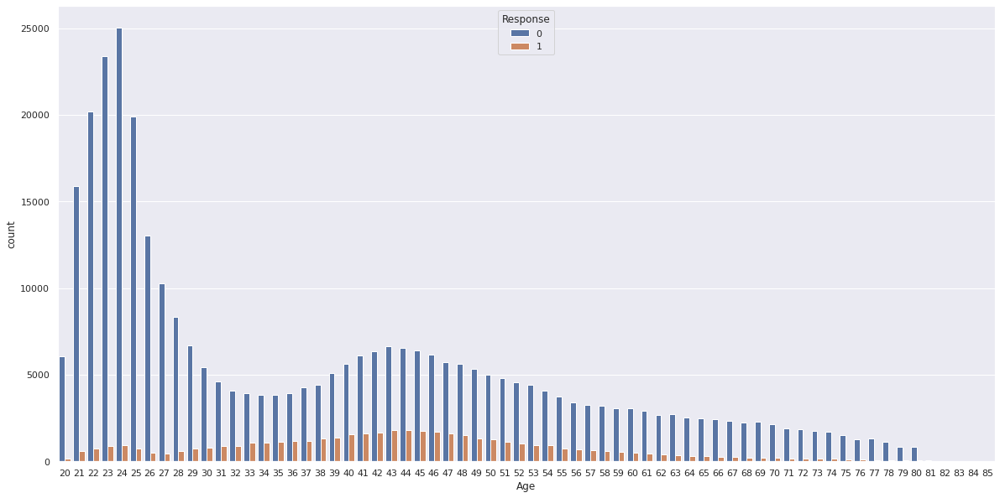

In [ ]:
# Response also depending on Age also... Bcoz In our day to day life, Some try to took insurance or some not as per their requirement.
plt.figure(figsize=(20,10))
sns.countplot(x='Age',hue='Response',data=health_df)

# <B> OBSERVATION : </B> <h6>
As per Graph shows, Young people below 30 are not interested in vehicle insurance. The reasons could be lack of experience, less maturity level and they don't have expensive vehicles yet.

People aged between 30-60 years are more likely to be interested.

In [ ]:
health_df['Response'].value_counts()

0    334399
1     46710
Name: Response, dtype: int64

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


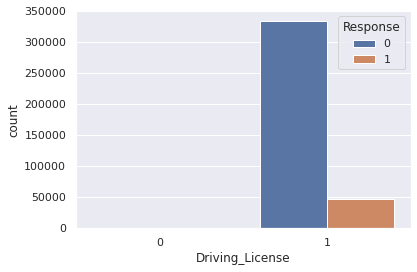

In [ ]:
# Lets check, how many of People having Driving Licence. 
sns.countplot(health_df['Driving_License'],hue=health_df['Response'])

In [ ]:
import plotly.express as px
fig = px.histogram(health_df, x="Vehicle_Damage", color='Response')
fig.show()

fig = px.histogram(health_df, x="Annual_Premium", color='Response')
fig.show()

#<B> OSERVATION : </B><h6>
That's Cool, Customers who are interested in Vehicle Insurance almost all have driving license.

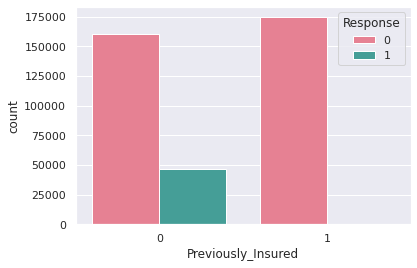

In [ ]:
# Now we will check relation between Previously Insuranced person and new person response for Insurance.
sns.countplot(x='Previously_Insured',hue='Response',data=health_df,palette='husl')

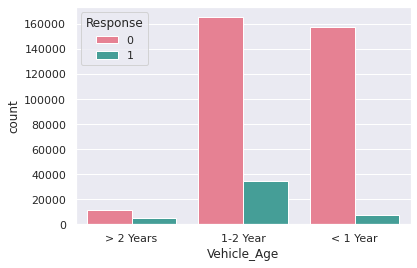

In [ ]:
# Now we will check relation between Vichele age and response for Insurance.
sns.countplot(x='Vehicle_Age',hue='Response',data=health_df,palette='husl')

#<B> OBSERVATION : </B> <h6>
Customer who are not perviosly insured are likely to be inetrested.

Customers with vechicle age 1-2 years are more likely to interested as compared to the other two.

Customers with with Vehicle_Age <1 years have very less chance of buying Insurance.


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


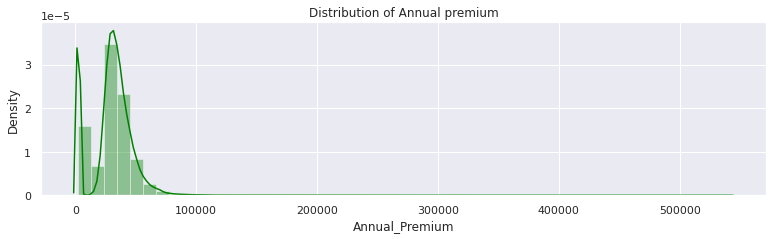

In [ ]:
# Checking Annual premimum Distribution in our data
plt.figure(figsize=(13,7))
plt.subplot(2,1,1)
sns.distplot(health_df['Annual_Premium'], color='green')
plt.title("Distribution of Annual premium")
plt.show()

Text(0.5, 1.05, 'Pearson correlation of Features')

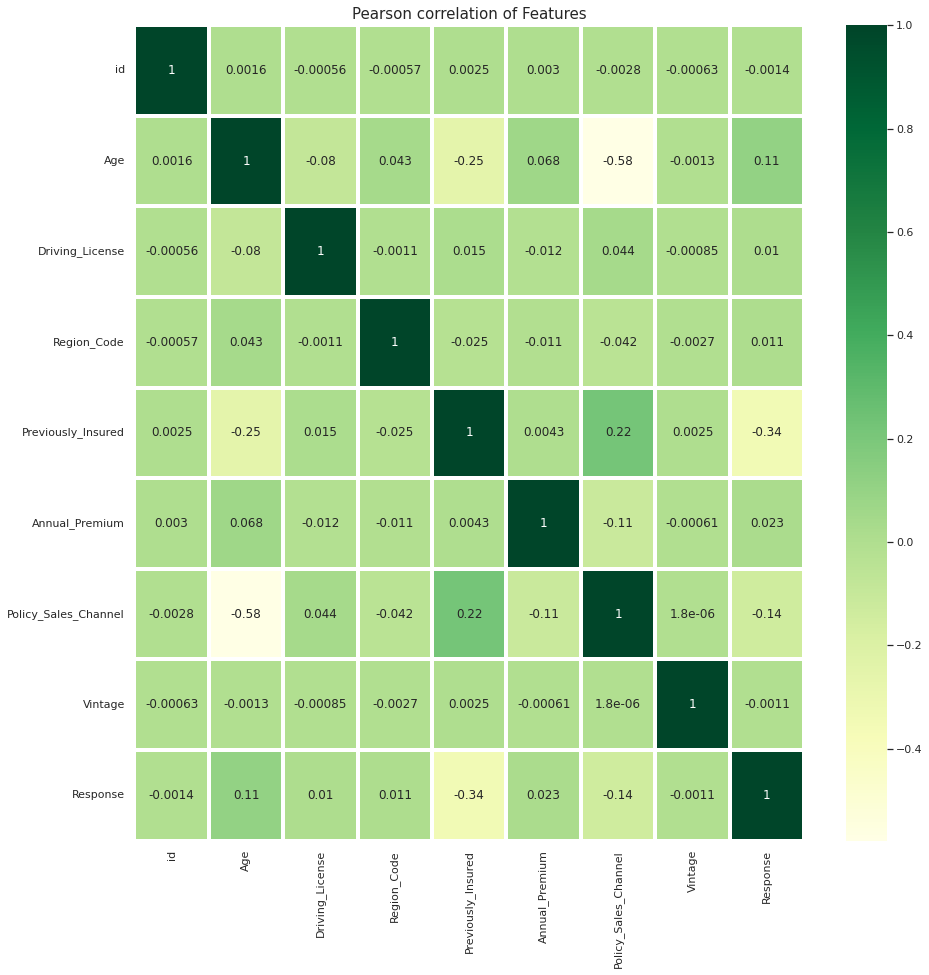

In [ ]:
# Correlation Matrix using Heatmap
corr = health_df.corr()
f, ax = plt.subplots(figsize=(15,15))
sns.heatmap(corr, ax=ax, annot=True,linewidths=3,cmap='YlGn')
plt.title("Pearson correlation of Features", y=1.05, size=15)

In [ ]:
health_df.corr()

,id,Age,Driving_License,Region_Code,Previously_Insured,Annual_Premium,Policy_Sales_Channel,Vintage,Response
id,1.000000,0.001561,-0.000564,-0.000572,0.002457,0.003027,-0.002837,-0.000630,-0.001368
Age,0.001561,1.000000,-0.079782,0.042574,-0.254682,0.067507,-0.577826,-0.001264,0.111147
Driving_License,-0.000564,-0.079782,1.000000,-0.001081,0.014969,-0.011906,0.043731,-0.000848,0.010155
Region_Code,-0.000572,0.042574,-0.001081,1.000000,-0.024659,-0.010588,-0.042420,-0.002750,0.010570
Previously_Insured,0.002457,-0.254682,0.014969,-0.024659,1.000000,0.004269,0.219381,0.002537,-0.341170
Annual_Premium,0.003027,0.067507,-0.011906,-0.010588,0.004269,1.000000,-0.113247,-0.000608,0.022575
Policy_Sales_Channel,-0.002837,-0.577826,0.043731,-0.042420,0.219381,-0.113247,1.000000,0.000002,-0.139042
Vintage,-0.000630,-0.001264,-0.000848,-0.002750,0.002537,-0.000608,0.000002,1.000000,-0.001050
Response,-0.001368,0.111147,0.010155,0.010570,-0.341170,0.022575,-0.139042,-0.001050,1.000000


# <B> OBSERVATION : </B> <h6>
Using Heatmap, We can drop the columns which will not affect the target varibale easily i.e Vintage column can be removed

# <B> Extra Trees Classifier</B> is a type of ensemble learning technique which aggregates the results of multiple de-correlated decision trees collected in a “forest” to output it’s classification result. 

OR 

The purpose of the Extra Trees Classifier is to fit a number of randomized decision trees to the data, and in this regard is a from of ensemble learning. Particularly, random splits of all observations are carried out to ensure that the model does not overfit the data.


[0.19346407 0.00602696 0.13932559 0.00047638 0.09305072 0.05536891
 0.01576026 0.07584995 0.16399518 0.06927266 0.18740931]


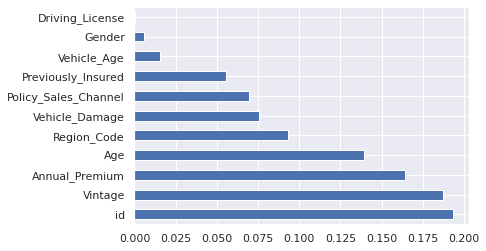

In [ ]:
from sklearn.ensemble import ExtraTreesClassifier
# use inbuilt class feature_importances of tree based class
model = ExtraTreesClassifier()
model.fit(X,Y)
print(model.feature_importances_)
# plot graph of feature importances for better visualization
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(11).plot(kind='barh')
plt.show()

# <B> OBSERVATION : </B> <h6>
We can remove less important features from the data set i.e. Driving Licence and Gender.

NOW, LET'S CHANGE THE CATEGORICAL DATA INTO NUMERICAL DATA

In [ ]:
labelEncoder= LabelEncoder()
health_df['Gender'] = labelEncoder.fit_transform(health_df['Gender'])
health_df['Vehicle_Age'] = labelEncoder.fit_transform(health_df['Vehicle_Age'])
health_df['Vehicle_Damage'] = labelEncoder.fit_transform(health_df['Vehicle_Damage'])
health_df['Region_Code'] = labelEncoder.fit_transform(health_df['Region_Code'])

In [ ]:
# Checking Data types of all Columns
health_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 381109 entries, 0 to 381108
Data columns (total 12 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   id                    381109 non-null  int64  
 1   Gender                381109 non-null  int64  
 2   Age                   381109 non-null  int64  
 3   Driving_License       381109 non-null  int64  
 4   Region_Code           381109 non-null  int64  
 5   Previously_Insured    381109 non-null  int64  
 6   Vehicle_Age           381109 non-null  int64  
 7   Vehicle_Damage        381109 non-null  int64  
 8   Annual_Premium        381109 non-null  float64
 9   Policy_Sales_Channel  381109 non-null  float64
 10  Vintage               381109 non-null  int64  
 11  Response              381109 non-null  int64  
dtypes: float64(2), int64(10)
memory usage: 34.9 MB


In [ ]:
# Checking is there any dulpicate data or not
duplicate=health_df[health_df.duplicated()]
print(duplicate)

Empty DataFrame
Columns: [id, Gender, Age, Driving_License, Region_Code, Previously_Insured, Vehicle_Age, Vehicle_Damage, Annual_Premium, Policy_Sales_Channel, Vintage, Response]
Index: []


# <B> OBSERVATION : </B> <h6>
The Numerical data is now changed.

There is no duplicate value in our data.

#<B> Many of the features are missing a significant amount of data. Let's Explore the columns further to determine the best approach for each. </B>

In [ ]:
# Missing Value Count Function
def show_missing():
    missing = health_df.columns[health_df.isnull().any()].tolist()
    return missing

# Missing data counts and percentage
print('Missing Data Count')
print(health_df[show_missing()].isnull().sum().sort_values(ascending = False))
print('--'*50)
print('Missing Data Percentage')
print(round(health_df[show_missing()].isnull().sum().sort_values(ascending = False)/len(health_df)*100,2))

Missing Data Count
Series([], dtype: float64)
----------------------------------------------------------------------------------------------------
Missing Data Percentage
Series([], dtype: float64)


In [ ]:
# Explore features
def feat_explore(column):
    return health_df[column].value_counts()

# Function to impute missing values
def feat_impute(column, value):
    health_df.loc[health_df[column].isnull(),column] = value

HANDLING OUTLIERS

In [ ]:
# find categorical variables
categorical = [var for var in health_df.columns if health_df[var].dtype=='O']
print('There are {} categorical variables'.format(len(categorical)))

There are 0 categorical variables


In [ ]:
# find Numerical variables
numerical = [var for var in health_df.columns if health_df[var].dtype!='O']
print('There are {} numerical variables'.format(len(numerical)))

There are 12 numerical variables


In [ ]:
# Checking discreate Variables
discrete = []
for var in numerical:
    if len(health_df[var].unique())<20:
        print(var, ' values: ', health_df[var].unique())
        discrete.append(var)
        
print('There are {} discrete variables'.format(len(discrete)))

Gender  values:  [1 0]
Driving_License  values:  [1 0]
Previously_Insured  values:  [0 1]
Vehicle_Age  values:  [2 0 1]
Vehicle_Damage  values:  [1 0]
Response  values:  [1 0]
There are 6 discrete variables


In [ ]:
continuous = [var for var in numerical if var not in discrete and var not in ['Id']]
continuous

['id',
 'Age',
 'Region_Code',
 'Annual_Premium',
 'Policy_Sales_Channel',
 'Vintage']

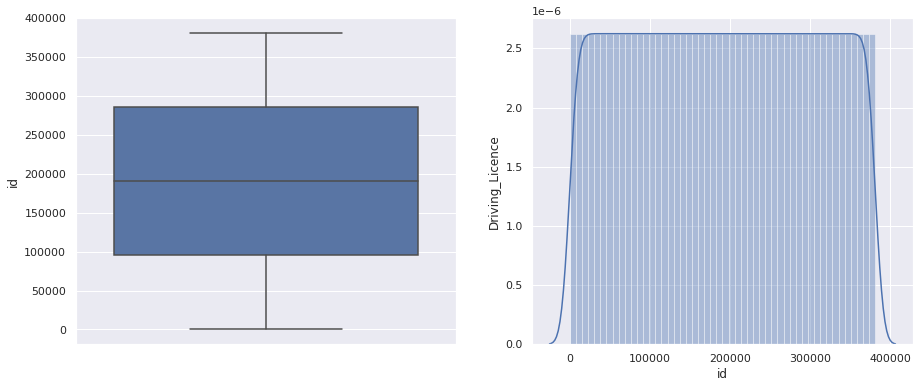

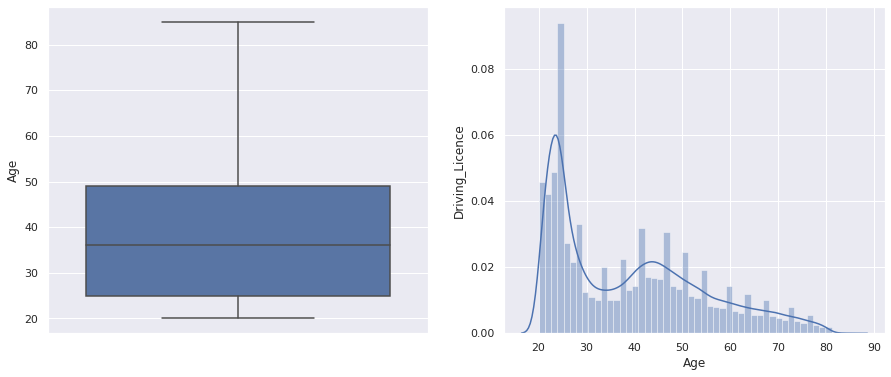

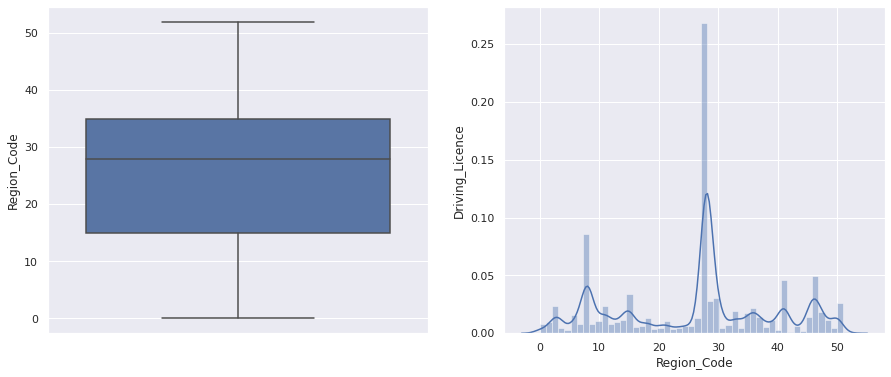

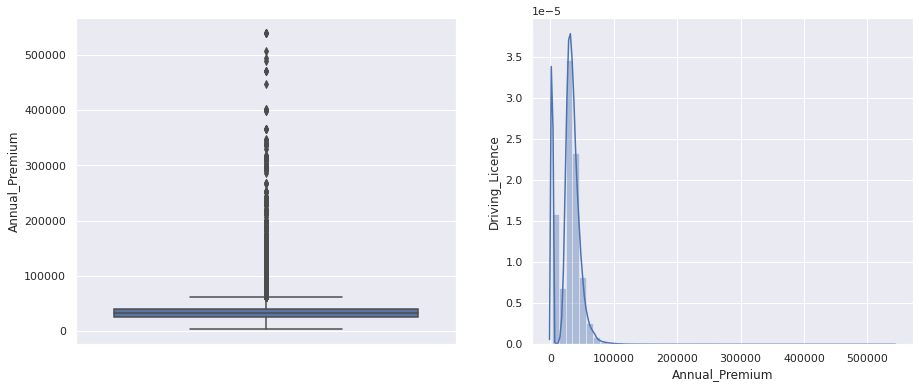

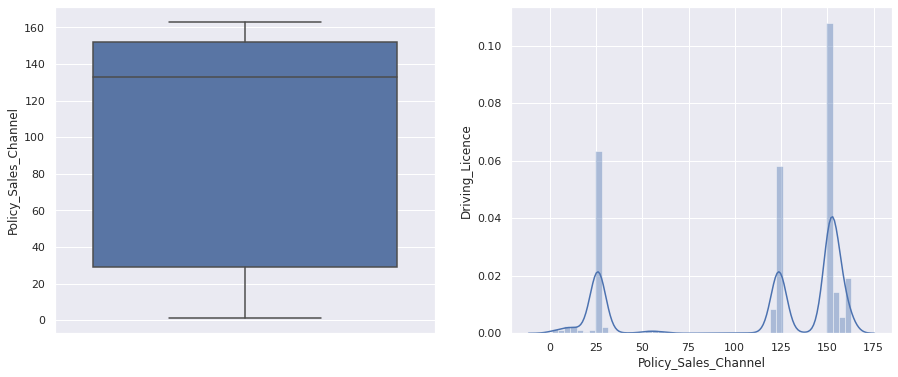

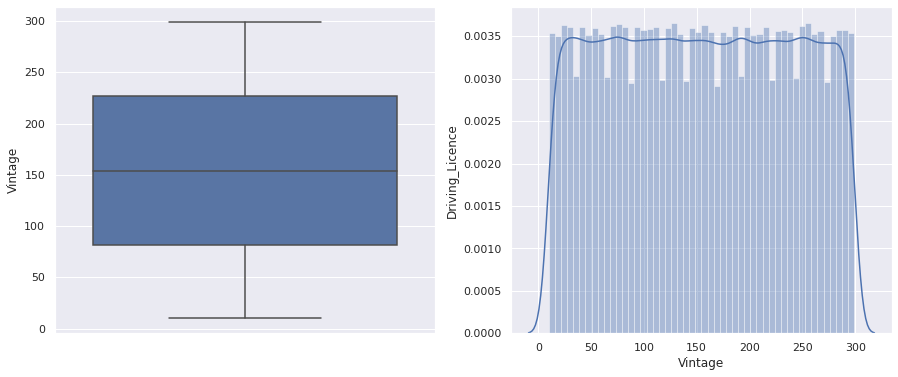

In [ ]:
for var in continuous:
    plt.figure(figsize=(15,6))
    plt.subplot(1, 2, 1)
    fig = sns.boxplot(y=health_df[var])
    fig.set_title('')
    fig.set_ylabel(var)
    
    plt.subplot(1, 2, 2)
    fig = sns.distplot(health_df[var].dropna())
    fig.set_ylabel('Driving_Licence')
    fig.set_xlabel(var)

    plt.show()

In [ ]:
# Outliers of Discreate Variables
for var in discrete:
    print(health_df[var].value_counts() / np.float(len(health_df)))
    print()

1    0.540761
0    0.459239
Name: Gender, dtype: float64

1    0.997869
0    0.002131
Name: Driving_License, dtype: float64

0    0.54179
1    0.45821
Name: Previously_Insured, dtype: float64

0    0.525613
1    0.432385
2    0.042001
Name: Vehicle_Age, dtype: float64

1    0.504877
0    0.495123
Name: Vehicle_Damage, dtype: float64

0    0.877437
1    0.122563
Name: Response, dtype: float64



Binning is the process of transforming numerical variables into categorical counterparts. Binning improves accuracy of the predictive models by reducing the noise or non-linearity in the dataset. Finally, binning lets easy identification of outliers, invalid and missing values of numerical variables.


In [ ]:
bins = [0, 5, 7,10]
pd.cut(health_df['Annual_Premium'], bins).value_counts()

(0, 5]     0
(5, 7]     0
(7, 10]    0
Name: Annual_Premium, dtype: int64

In [ ]:
health_df['Annual_Premium'] = pd.cut(health_df['Annual_Premium'], bins)
health_df['Annual_Premium']

0         NaN
1         NaN
2         NaN
3         NaN
4         NaN
         ... 
381104    NaN
381105    NaN
381106    NaN
381107    NaN
381108    NaN
Name: Annual_Premium, Length: 381109, dtype: category
Categories (3, interval[int64, right]): [(0, 5] < (5, 7] < (7, 10]]

# <B> Reducing Cardinilty </B> 
If We want to reduce cardinality then keep the level same categorical labels

In [ ]:
#Let's now check if our categorical variables have a huge number of categories. 
#This may be a problem for some machine learning models.
for var in categorical:
    print(var, ' contains ', len(health_df[var].unique()), ' labels')

In [ ]:
# Encode Categorical Variables - one hot encoding
from sklearn.preprocessing import OneHotEncoder 
onehotencoder = OneHotEncoder() 
one_hot_Foundation = onehotencoder.fit_transform(np.array(health_df['Annual_Premium']).reshape(-1,1)).toarray() 
one_hot_Foundation

array([[1.],
       [1.],
       [1.],
       ...,
       [1.],
       [1.],
       [1.]])

In [ ]:
np.sum(one_hot_Foundation,axis=0)

array([381109.])

NOW, SEPARATING DEPENDENT AND INDEPENDENT VARIABLE


In [ ]:
# Independent variable
X=health_df.drop(['Response'],axis=1)
# Dependent variable
Y=health_df['Response']           

In [ ]:
X.shape, Y.shape

((381109, 11), (381109,))

TRAIN - TEST SPLIT ON VARIABLE X AND Y

In [ ]:
# Train-test split
X_train, X_test, Y_train, Y_test = train_test_split(X,Y,test_size = 0.25, random_state=1)

In [ ]:
# Check the shape of train dataset
print(X_train.shape,Y_train.shape)

# Check the shape of test dataset
print(X_test.shape, Y_test.shape)

(285831, 11) (285831,)
(95278, 11) (95278,)


In [ ]:
X_train.isnull().sum(), X_test.isnull().sum(), Y_train.isnull().sum(), Y_test.isnull().sum()

(id                      0
 Gender                  0
 Age                     0
 Driving_License         0
 Region_Code             0
 Previously_Insured      0
 Vehicle_Age             0
 Vehicle_Damage          0
 Annual_Premium          0
 Policy_Sales_Channel    0
 Vintage                 0
 dtype: int64, id                      0
 Gender                  0
 Age                     0
 Driving_License         0
 Region_Code             0
 Previously_Insured      0
 Vehicle_Age             0
 Vehicle_Damage          0
 Annual_Premium          0
 Policy_Sales_Channel    0
 Vintage                 0
 dtype: int64, 0, 0)

In [ ]:
# Feature Scaling
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
X_train=scaler.fit_transform(X_train)
print(f'X_train is {X_train}')
X_test=scaler.transform(X_test)
print(f'X_test is {X_test}')

X_train is [[-1.14792085 -1.08590418  0.58996013 ...  0.25149614 -1.58586172
   1.69346302]
 [-1.29956721 -1.08590418  1.16998036 ...  1.43134091 -1.58586172
  -0.66160371]
 [-0.69116291 -1.08590418 -1.21454725 ... -0.57095673  0.88527568
   0.62949886]
 ...
 [ 1.10605793  0.92089157  0.39662006 ...  0.18284263  0.22138802
  -0.41055598]
 [ 0.69804509 -1.08590418  0.26772667 ...  0.26428908  0.73774509
  -0.55401183]
 [-0.5687727   0.92089157  0.58996013 ...  0.37161085  0.22138802
   0.71318144]]
X_test is [[-1.14984883 -1.08590418 -0.95676048 ... -0.2707568   0.73774509
   0.60558956]
 [-0.2211183  -1.08590418 -0.18340017 ... -0.47116023  0.18450537
   1.59782579]
 [ 1.64038969  0.92089157  1.10553367 ...  0.23320398 -1.58586172
   1.60978045]
 ...
 [ 0.05904779  0.92089157 -0.89231379 ... -0.24198716 -1.58586172
   0.85663728]
 [ 1.29829187 -1.08590418 -0.69897371 ...  0.22579449  0.73774509
  -0.14755361]
 [-0.03044858  0.92089157 -1.15010056 ...  0.05242411  0.88527568
  -0.721376

# <B> MODEL SELECTION : </B>
Problem can be identified that wheather customer will be interested for vehicle insurance or not.

 1. Logistic Regression

 2. Random Forest

 3. XGBClassifier


# <B> MODEL -1 LOGISTIC REGRESSION </B>

In [ ]:
model=LogisticRegression()
model=model.fit(X_train, Y_train)
pred=model.predict(X_test)
lr_probability =model.predict_proba(X_test)[:,1]

In [ ]:
acc_lr = accuracy_score(Y_test, pred)
print(f'Accuracy of Logistic Regression : {acc_lr}')

Accuracy of Logistic Regression : 0.8785973677029325


In [ ]:
# Recall helps us to measure how many positive samples were correctly classified by the ML model.
recall_lr = recall_score(Y_test, pred)
recall_lr

0.0

In [ ]:
# Precision helps us to measure the ability to classify positive samples in the model.	
precision_lr = precision_score(Y_test, pred)
precision_lr

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


0.0

In [ ]:
# F1 score conveys the balance between the precision and the recall
f1score_lr = f1_score(Y_test, pred)
f1score_lr

0.0

In [ ]:
roc_auc_lr = roc_auc_score(Y_test, pred)
print("ROC_AUC Score IN Logistic MODEL:",roc_auc_lr)

ROC_AUC Score IN Logistic MODEL: 0.5


In [ ]:
# Printing Classification report using prediction and Y_test
print(f'Classification report using prediction and Y_test for Logistic Regression : \n {classification_report(pred,Y_test)}')

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification report using prediction and Y_test for Logistic Regression : 
               precision    recall  f1-score   support

           0       1.00      0.88      0.94     95278
           1       0.00      0.00      0.00         0

    accuracy                           0.88     95278
   macro avg       0.50      0.44      0.47     95278
weighted avg       1.00      0.88      0.94     95278



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


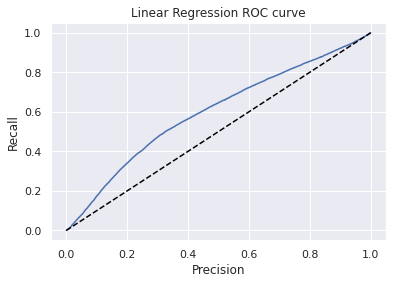

In [ ]:
# ROC (Receiver Operating Characteristics) Curve is a metric used to measure the performance of a classifier model. 
# It depicts the rate of true positives w.r.t. rate of false positives, therefore highlighting the sensitivity of the classifier model.
from sklearn.metrics import roc_curve
fpr, tpr, _ = roc_curve(Y_test, lr_probability)

plt.title('Linear Regression ROC curve')
plt.xlabel('Precision')
plt.ylabel('Recall')

plt.plot(fpr,tpr)
plt.plot((0,1), ls='dashed',color='black')
plt.show()

[[83711     0]
 [11567     0]]


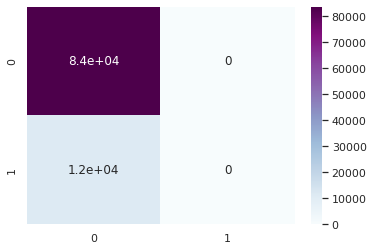

In [ ]:
# Confusion matrix is an N x N matrix used for evaluating the performance of a classification model, where N is the number of target classes. 
# The matrix compares the actual target values with those predicted by the machine learning model.
cm=confusion_matrix(Y_test,pred)
print(cm)
sns.heatmap(cm,annot=True,cmap='BuPu')

# <B> MODEL - 2 RANDOM FOREST CLASSIFIER

In [ ]:
from sklearn.ensemble import RandomForestClassifier
randomforest = RandomForestClassifier()

In [ ]:
randomforest=randomforest.fit(X_train, Y_train)
randomforest

RandomForestClassifier()

In [ ]:
# Prediction in Random Forest
Y_pred = randomforest.predict(X_test)
Y_pred

array([0, 0, 0, ..., 0, 0, 0])

In [ ]:
# Prediction of probability in RFC
RF_probability = randomforest.predict_proba(X_test)[:,1]
RF_probability

array([0.  , 0.  , 0.32, ..., 0.  , 0.08, 0.  ])

In [ ]:
# ROC-AUC Score in RFC MODEL
AUC_RF = roc_auc_score(Y_pred, Y_test)
print(f'ROC-AUC Score in RFC MODEL: {AUC_RF}')

ROC-AUC Score in RFC MODEL: 0.6296826263423799


In [ ]:
# Accuracy score in RFC Model
acc_rf = accuracy_score(Y_test,Y_pred)
print(f'ACCURACY Score in RFC MODEL: {acc_rf}')

ACCURACY Score in RFC MODEL: 0.8726463611746678


In [ ]:
# Recall Score in RFC MODEL
recall_rf = recall_score(Y_test,Y_pred)
print(f'Recall Score in RFC MODEL: {recall_rf}')

Recall Score in RFC MODEL: 0.07322555545949684


In [ ]:
# Precision Score in RFC MODEL
precision_rf = precision_score(Y_test,Y_pred)
print(f'Precision Score in RFC MODEL: {precision_rf}')

Precision Score in RFC MODEL: 0.3746130030959752


In [ ]:
# F1 Score in RFC MODEL
f1score_rf = f1_score(Y_test,Y_pred)
print(f'F1 Score in RFC MODEL: {f1score_rf}')

F1 Score in RFC MODEL: 0.12250506219265259


In [ ]:
print(accuracy_score(Y_pred,Y_test))
print("ROC_AUC Score IN RFC MODEL:",AUC_RF)

0.8726463611746678
ROC_AUC Score IN RFC MODEL: 0.6296826263423799


In [ ]:
# Classification Report of RFC MODEL
print(classification_report(Y_pred,Y_test))

              precision    recall  f1-score   support

           0       0.98      0.88      0.93     93017
           1       0.07      0.37      0.12      2261

    accuracy                           0.87     95278
   macro avg       0.53      0.63      0.53     95278
weighted avg       0.96      0.87      0.91     95278



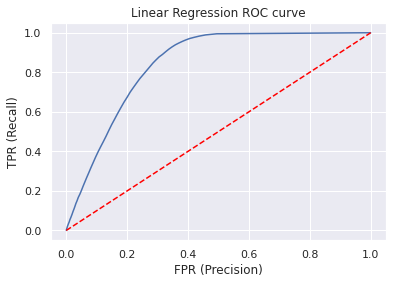

In [ ]:
# ROC Curve IN RFC MODEL
from sklearn.metrics import roc_curve
fpr, tpr, _ = roc_curve(Y_test, RF_probability)

plt.title('Linear Regression ROC curve')
plt.xlabel('FPR (Precision)')
plt.ylabel('TPR (Recall)')

plt.plot(fpr,tpr)
plt.plot((0,1), ls='dashed',color='red')
plt.show()


The Confusion matrix is [[82297 10720]
 [ 1414   847]]


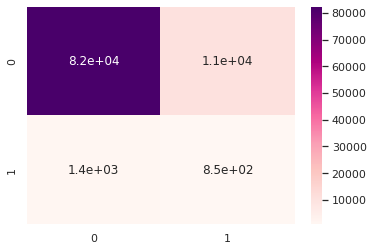

In [ ]:
# Confusion Matrix in RFC MODEL
cm=confusion_matrix(Y_pred,Y_test)
print(f'The Confusion matrix is {cm}')
sns.heatmap(cm,annot=True,cmap='RdPu')

#<B> MODEL - 3 XGB CLASSIFIER

In [ ]:
from xgboost import XGBClassifier
xgb=XGBClassifier()

In [ ]:
XGB_fit=xgb.fit(X_train, Y_train)
XGB_fit

XGBClassifier()

In [ ]:
# Prediction in XGB Classifier Model
Y_predict = XGB_fit.predict(X_test)
print(f'Prediction in XGB Classifier Model :{Y_predict}')

Prediction in XGB Classifier Model :[0 0 0 ... 0 0 0]


In [ ]:
# Probability in XGB Classifier Model
XGB_probability = XGB_fit.predict_proba(X_test)[:,1]
print(f'Probability in XGB Classifier Model :{XGB_probability}')

Probability in XGB Classifier Model :[0.00065216 0.00115454 0.2690377  ... 0.00088914 0.2301061  0.00080058]


In [ ]:
# Accuracy in XGB Classifier Model
acc_xgb = accuracy_score(Y_test,Y_predict)
print(f'Accuracy in XGB Classifier Model :{acc_xgb}')

Accuracy in XGB Classifier Model :0.8785973677029325


In [ ]:
# Recall Score in XGB Classifier Model
recall_xgb = recall_score(Y_test,Y_predict)
print(f'Recall Score in XGB Classifier Model :{recall_xgb}')

Recall Score in XGB Classifier Model :0.0


In [ ]:
# Precision in XGB Classifier Model
precision_xgb = precision_score(Y_test,Y_predict)
print(f'Precision Score in XGB Classifier Model :{precision_xgb}')

Precision Score in XGB Classifier Model :0.0


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
# F1 Score in XGB Classifier Model
f1score_xgb = f1_score(Y_test,Y_predict)
print(f'Recall Score in XGB Classifier Model :{f1score_xgb}')

Recall Score in XGB Classifier Model :0.0


In [ ]:
# ROC-AUC Score in XGB Classifier Model
AUC_xgb = roc_auc_score(Y_test, Y_predict)
print("ROC_AUC Score:",AUC_xgb)

ROC_AUC Score: 0.5


In [ ]:
# Classification Report in XGB Classifier MODEL
print(classification_report(Y_predict,Y_test))

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       1.00      0.88      0.94     95278
           1       0.00      0.00      0.00         0

    accuracy                           0.88     95278
   macro avg       0.50      0.44      0.47     95278
weighted avg       1.00      0.88      0.94     95278



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


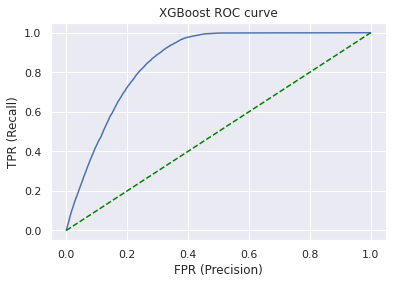

In [ ]:
# ROC Curve in XGB Classifier
from sklearn.metrics import roc_curve
fpr, tpr, _ = roc_curve(Y_test, XGB_probability)

plt.title('XGBoost ROC curve')
plt.xlabel('FPR (Precision)')
plt.ylabel('TPR (Recall)')

plt.plot(fpr,tpr)
plt.plot((0,1), ls='dashed',color='green')
plt.show()

The confusion Matrix is 
 [[83711     0]
 [11567     0]]


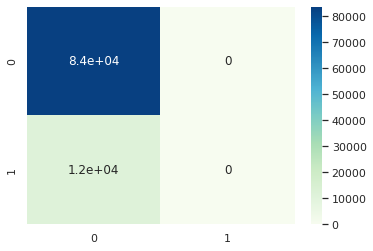

In [ ]:
#Confusion Matrix helps to identify how many values are classified correctly
cm=confusion_matrix(Y_test,Y_predict)
print(f'The confusion Matrix is \n {cm}')
sns.heatmap(cm,annot=True,cmap='GnBu')

# <B> <center> COMPARISON OF ALL 3 MODEL </B>



In [ ]:
ind=['Logistic regression','Randomforest','XGBClassifier']
data={"Accuracy":[acc_lr,acc_rf,acc_xgb],"Recall":[recall_lr,recall_rf,recall_xgb],"Precision":[precision_lr,precision_rf,precision_xgb],
    'f1_score':[f1score_lr,f1score_rf,f1score_xgb],"ROC_AUC":[roc_auc_lr,AUC_RF,AUC_xgb]}
result=pd.DataFrame(data=data,index=ind)
print(f'The result of all 3 model as shown below \n {result}')

The result of all 3 model as shown below 
                      Accuracy    Recall  Precision  f1_score   ROC_AUC
Logistic regression  0.878597  0.000000   0.000000  0.000000  0.500000
Randomforest         0.872646  0.073226   0.374613  0.122505  0.629683
XGBClassifier        0.878597  0.000000   0.000000  0.000000  0.500000


ML model for the problem statement was created using python with the help of the dataset.

ML model created with Random Forest and XGBClassifier models performed better than Logistics Regression model. 

Thus, for the given problem, the models created by Random Forest and XGBClassifier.



# <B> <Center> CONCLUSION </B>
*   Customers with Vehicle_Damage are likely to buy insurance.

*   The variable such as Age, Previously_insured, Annual_premium are more affecting the target variable.

*   By comparing ROC curve, we observed Random Forest model preform better because curves closer to the top-left corner i.e. it indicate a better performance.